In [5]:
try:
    from google.colab import drive
    IN_COLAB = True
except:
    IN_COLAB = False
    
if IN_COLAB:
    drive.mount('/content/drive')

Mounted at /content/drive


In [7]:
%cd '/content/drive/MyDrive/GANS/VAE'

/content/drive/MyDrive/GANS/VAE


In [1]:
from IPython.display import Image

In [57]:
import math
import torch
from collections import OrderedDict

torch.manual_seed(0)
import torch.nn as nn
import torch.nn.functional as F
import torch.utils
import torch.distributions
import torchvision
import numpy as np
import matplotlib.pyplot as plt
from matplotlib import gridspec
from sklearn.decomposition import PCA

plt.rcParams["figure.dpi"] = 200
from tqdm.notebook import tqdm
from torch.utils.tensorboard import SummaryWriter

from torchvision import datasets, transforms

In [3]:
import warnings
warnings.filterwarnings("ignore")

In [4]:
device = "cuda" if torch.cuda.is_available() else "cpu"
device

'cuda'

## Модель

In [11]:
class Reshape(torch.nn.Module):
    @property
    def device(self):
        return next(self.parameters()).device

    def __init__(self, *args):
        super(Reshape, self).__init__()
        self.dims = args

    def forward(self, input):
        return input.view(input.size(0), *self.dims)

In [12]:
class VariationalEncoder(nn.Module):
    @property
    def device(self):
        return next(self.parameters()).device

    def __init__(self, latent_dim):
        super(type(self), self).__init__()
        self.latent_dim = latent_dim

        self.layer1 = nn.Sequential(
            OrderedDict(
                [
                    (
                        "conv1",
                        torch.nn.Conv2d(1, 8, kernel_size=5, bias=False),
                    ),  # (N, 8, 24, 24)
                    ("bnorm1", torch.nn.BatchNorm2d(8)),
                    ("lrelu1", nn.LeakyReLU(0.1)),
                    ("pool1", torch.nn.MaxPool2d(kernel_size=2)),  # (N, 8, 12, 12)
                ]
            )
        )

        self.layer2 = nn.Sequential(
            OrderedDict(
                [
                    (
                        "conv2",
                        torch.nn.Conv2d(8, 20, kernel_size=5, bias=False),
                    ),  # (N, 20, 8, 8)
                    ("bnorm2", torch.nn.BatchNorm2d(20)),
                    ("lrelu2", nn.LeakyReLU(0.1)),
                    ("pool2", torch.nn.MaxPool2d(kernel_size=2)),  # (N, 20, 4, 4)
                ]
            )
        )

        self.layer3 = nn.Sequential(
            OrderedDict(
                [
                    (
                        "conv3",
                        torch.nn.Conv2d(20, 100, kernel_size=3),
                    ),  # (N, 100, 2, 2)
                    ("lrelu3", nn.LeakyReLU(0.1)),
                    ("pool3", torch.nn.MaxPool2d(kernel_size=2)),  # (N, 100, 1, 1)
                    ("flatten", torch.torch.nn.Flatten(start_dim=1)),  # (N, 100)
                ]
            )
        )
        self.linear1 = nn.Linear(100, 200)
        self.linear2 = nn.Linear(200, latent_dim)
        self.linear3 = nn.Linear(200, latent_dim)

        self.N = torch.distributions.Normal(0, 1)
        self.N.loc = self.N.loc.to(device)
        self.N.scale = self.N.scale.to(device)
        self.kl = 0

    def forward(self, x):
        x = self.layer3(self.layer2(self.layer1(x)))
        x = self.linear1(x)

        mu = self.linear2(x)
        sigma = torch.exp(self.linear3(x))
        z = mu + sigma * self.N.sample(mu.shape)
        self.kl = (sigma**2 + mu**2 - torch.log(sigma) - 1 / 2).sum()
        return z

In [13]:
class VariationalDecoder(torch.nn.Module):
    @property
    def device(self):
        return next(self.parameters()).device

    def __init__(self, latent_dim):
        super(type(self), self).__init__()
        self.latent_dim = latent_dim
        self.linear1 = nn.Linear(latent_dim, 100)

        self.layer1 = nn.Sequential(
            OrderedDict(
                [
                    ("reshape", Reshape(100, 1, 1)),  # (N, 100, 1, 1)
                    (
                        "conv1",
                        torch.nn.ConvTranspose2d(100, 128, 4, 1, 0, 0, bias=False),
                    ),  #  (N, 128, 4, 4)
                    ("bnorm1", torch.nn.BatchNorm2d(128)),
                    ("lrelu1", nn.LeakyReLU(0.1)),
                ]
            )
        )

        self.layer2 = nn.Sequential(
            OrderedDict(
                [
                    (
                        "conv2",
                        torch.nn.ConvTranspose2d(128, 64, 3, 2, 1, 0, bias=False),
                    ),  #  (N, 64, 7, 7)
                    ("bnorm2", torch.nn.BatchNorm2d(64)),
                    ("lrelu2", nn.LeakyReLU(0.1)),
                ]
            )
        )

        self.layer3 = nn.Sequential(
            OrderedDict(
                [
                    (
                        "conv3",
                        torch.nn.ConvTranspose2d(64, 32, 3, 2, 1, 1, bias=False),
                    ),  #  (N, 32, 14, 14)
                    ("bnorm3", torch.nn.BatchNorm2d(32)),
                    ("lrelu3", nn.LeakyReLU(0.1)),
                ]
            )
        )

        self.layer4 = nn.Sequential(
            OrderedDict(
                [
                    (
                        "conv4",
                        torch.nn.ConvTranspose2d(32, 1, 4, 2, 1, 0),
                    ),  #  (N, 1, 28, 28)
                    ("lrelu4", nn.LeakyReLU(0.1)),
                    ("sigmoid", torch.nn.Sigmoid()),
                ]
            )
        )

    def forward(self, x):
        out = self.linear1(x)
        return self.layer4(self.layer3(self.layer2(self.layer1(out))))

In [14]:
class VariationalAutoencoder(nn.Module):
    @property
    def device(self):
        return next(self.parameters()).device

    def __init__(self, latent_dim):
        super(type(self), self).__init__()
        self.latent_dim = latent_dim

        self.encoder = VariationalEncoder(latent_dim)
        self.decoder = VariationalDecoder(latent_dim)

    def forward(self, x):
        z = self.encoder(x)
        return self.decoder(z)

    def encode(self, x):
        return self.encoder(x)

    def decode(self, z):
        return self.decoder(z)

## Код для обучения

In [15]:
def train_on_batch(model, x_batch, optimizer, loss_function):
    model.train()
    optimizer.zero_grad()
    
    x_batch_hat = model(x_batch.to(model.device))

    loss = loss_function(x_batch_hat, x_batch.to(model.device))
    loss.backward()

    optimizer.step()
    return loss.cpu().item()

In [36]:
def train_epoch(train_generator, model, loss_function, optimizer, callback=None):
    epoch_loss = 0
    total = 0
    for it, (x_batch, _) in enumerate(train_generator):
        batch_loss = train_on_batch(model, x_batch, optimizer, loss_function)

        if callback:
            with torch.no_grad():
                callback(model, batch_loss)

        # Calculate corrected with respect to batch size loss
        epoch_loss += batch_loss * len(x_batch)
        total += len(x_batch)

    return epoch_loss / total

In [17]:
def trainer(
    count_of_epoch,
    batch_size,
    dataset,
    model,
    loss_function,
    optimizer,
    lr=0.001,
    callback=None,
):

    optima = optimizer(model.parameters(), lr=lr)

    iterations = tqdm(range(count_of_epoch), desc="epoch")
    iterations.set_postfix({"train epoch loss": np.nan})
    for it in iterations:
        batch_generator = tqdm(
            torch.utils.data.DataLoader(
                dataset=dataset, batch_size=batch_size, shuffle=True
            ),
            leave=False,
            total=len(dataset) // batch_size + (len(dataset) % batch_size > 0),
        )

        epoch_loss = train_epoch(
            train_generator=batch_generator,
            model=model,
            loss_function=loss_function,
            optimizer=optima,
            callback=callback,
        )

        iterations.set_postfix({"train epoch loss": epoch_loss})

In [38]:
class Callback(object):
    def __init__(self, writer, dataset, loss_function, delimeter=100, batch_size=128):
        self.step = 0
        self.writer = writer
        self.delimeter = delimeter

        self.dataset = dataset
        self.loss_function = loss_function
        self.batch_size = batch_size

    def forward(self, model, loss):
        self.step += 1
        self.writer.add_scalar("LOSS/train", loss, self.step)

        if self.step % self.delimeter == 0:
            batch_generator = torch.utils.data.DataLoader(
                dataset=self.dataset, batch_size=self.batch_size
            )

            test_loss = 0
            model.eval()
            for it, (x_batch, _) in enumerate(batch_generator):
                x_batch = x_batch.to(model.device)
                x_batch_hat = model(x_batch)
                batch_loss = self.loss_function(x_batch_hat, x_batch).cpu().item()
                test_loss += batch_loss * len(x_batch)
            test_loss /= len(self.dataset)

            self.writer.add_scalar("LOSS/test", test_loss, self.step)

            x = x_batch[-10:]
            fig = plt.figure(figsize=(12, 12 / 10 * (x.shape[0] // 10 + 1)))
            gs = gridspec.GridSpec(1, x.shape[0])
            
            x_hat = torch.squeeze(model(x.to(model.device))).to('cpu').numpy()
            for i in range(x.shape[0]):
                ax = fig.add_subplot(gs[i])
                ax.imshow(
                    x_hat[i],
                    cmap="Greys_r",
                    interpolation="lanczos",
                )
                ax.axis("off")

            self.writer.add_figure("VISUAL/Reconstruction", fig, self.step)

    def __call__(self, model, loss):
        return self.forward(model, loss)

## Данные

In [21]:
dataset = datasets.MNIST('./mnist', train=True, download=True, 
                             transform=transforms.ToTensor())

test_dataset = datasets.MNIST('./mnist', train=False, download=True,
                            transform=transforms.ToTensor())

  0%|          | 0/9912422 [00:00<?, ?it/s]

Extracting ./mnist/MNIST/raw/train-images-idx3-ubyte.gz to ./mnist/MNIST/raw



  0%|          | 0/28881 [00:00<?, ?it/s]

Extracting ./mnist/MNIST/raw/train-labels-idx1-ubyte.gz to ./mnist/MNIST/raw



  0%|          | 0/1648877 [00:00<?, ?it/s]

Extracting ./mnist/MNIST/raw/t10k-images-idx3-ubyte.gz to ./mnist/MNIST/raw



  0%|          | 0/4542 [00:00<?, ?it/s]

Extracting ./mnist/MNIST/raw/t10k-labels-idx1-ubyte.gz to ./mnist/MNIST/raw



In [22]:
for x_batch, _ in torch.utils.data.DataLoader(dataset=dataset, batch_size=64, shuffle=True):
    print(x_batch.dtype)
    break

torch.float32


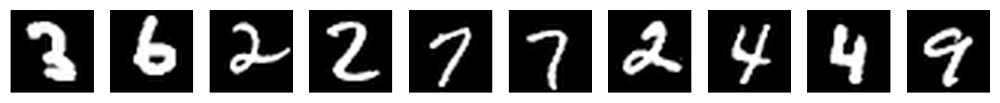

In [23]:
x = torch.squeeze(x_batch[-10:]).to('cpu').numpy()

fig = plt.figure(figsize=(12, 12 / 10 * (x.shape[0] // 10 + 1)))
gs = gridspec.GridSpec(1, x.shape[0])

for i in range(x.shape[0]):
    ax = fig.add_subplot(gs[i])
    ax.imshow(
        x[i],
        cmap="Greys_r",
        interpolation="lanczos",
    )
    ax.axis("off")

## Обучение

In [24]:
loss_function = torch.nn.MSELoss()
optimizer = torch.optim.Adam

In [39]:
saved_models = []

for latent_dim in [2, 4, 8, 16, 32, 64, 128]:
    autoencoder = VariationalAutoencoder(latent_dim)
    _ = autoencoder.to(device)
    
    writer = SummaryWriter(log_dir=f"autoencoder/Latent_{latent_dim}")
    callback = Callback(writer, test_dataset, loss_function)

    trainer(
        count_of_epoch=10,
        batch_size=128,
        dataset=dataset,
        model=autoencoder,
        loss_function=loss_function,
        optimizer=optimizer,
        lr=0.001,
        callback=callback,
    )
    
    if not int(math.log(latent_dim, 2)) % 2:
        saved_models.append(autoencoder)

epoch:   0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/469 [00:00<?, ?it/s]

  0%|          | 0/469 [00:00<?, ?it/s]

  0%|          | 0/469 [00:00<?, ?it/s]

  0%|          | 0/469 [00:00<?, ?it/s]

  0%|          | 0/469 [00:00<?, ?it/s]

  0%|          | 0/469 [00:00<?, ?it/s]

  0%|          | 0/469 [00:00<?, ?it/s]

  0%|          | 0/469 [00:00<?, ?it/s]

  0%|          | 0/469 [00:00<?, ?it/s]

  0%|          | 0/469 [00:00<?, ?it/s]

epoch:   0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/469 [00:00<?, ?it/s]

  0%|          | 0/469 [00:00<?, ?it/s]

  0%|          | 0/469 [00:00<?, ?it/s]

  0%|          | 0/469 [00:00<?, ?it/s]

  0%|          | 0/469 [00:00<?, ?it/s]

  0%|          | 0/469 [00:00<?, ?it/s]

  0%|          | 0/469 [00:00<?, ?it/s]

  0%|          | 0/469 [00:00<?, ?it/s]

  0%|          | 0/469 [00:00<?, ?it/s]

  0%|          | 0/469 [00:00<?, ?it/s]

epoch:   0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/469 [00:00<?, ?it/s]

  0%|          | 0/469 [00:00<?, ?it/s]

  0%|          | 0/469 [00:00<?, ?it/s]

  0%|          | 0/469 [00:00<?, ?it/s]

  0%|          | 0/469 [00:00<?, ?it/s]

  0%|          | 0/469 [00:00<?, ?it/s]

  0%|          | 0/469 [00:00<?, ?it/s]

  0%|          | 0/469 [00:00<?, ?it/s]

  0%|          | 0/469 [00:00<?, ?it/s]

  0%|          | 0/469 [00:00<?, ?it/s]

epoch:   0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/469 [00:00<?, ?it/s]

  0%|          | 0/469 [00:00<?, ?it/s]

  0%|          | 0/469 [00:00<?, ?it/s]

  0%|          | 0/469 [00:00<?, ?it/s]

  0%|          | 0/469 [00:00<?, ?it/s]

  0%|          | 0/469 [00:00<?, ?it/s]

  0%|          | 0/469 [00:00<?, ?it/s]

  0%|          | 0/469 [00:00<?, ?it/s]

  0%|          | 0/469 [00:00<?, ?it/s]

  0%|          | 0/469 [00:00<?, ?it/s]

epoch:   0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/469 [00:00<?, ?it/s]

  0%|          | 0/469 [00:00<?, ?it/s]

  0%|          | 0/469 [00:00<?, ?it/s]

  0%|          | 0/469 [00:00<?, ?it/s]

  0%|          | 0/469 [00:00<?, ?it/s]

  0%|          | 0/469 [00:00<?, ?it/s]

  0%|          | 0/469 [00:00<?, ?it/s]

  0%|          | 0/469 [00:00<?, ?it/s]

  0%|          | 0/469 [00:00<?, ?it/s]

  0%|          | 0/469 [00:00<?, ?it/s]

epoch:   0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/469 [00:00<?, ?it/s]

  0%|          | 0/469 [00:00<?, ?it/s]

  0%|          | 0/469 [00:00<?, ?it/s]

  0%|          | 0/469 [00:00<?, ?it/s]

  0%|          | 0/469 [00:00<?, ?it/s]

  0%|          | 0/469 [00:00<?, ?it/s]

  0%|          | 0/469 [00:00<?, ?it/s]

  0%|          | 0/469 [00:00<?, ?it/s]

  0%|          | 0/469 [00:00<?, ?it/s]

  0%|          | 0/469 [00:00<?, ?it/s]

epoch:   0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/469 [00:00<?, ?it/s]

  0%|          | 0/469 [00:00<?, ?it/s]

  0%|          | 0/469 [00:00<?, ?it/s]

  0%|          | 0/469 [00:00<?, ?it/s]

  0%|          | 0/469 [00:00<?, ?it/s]

  0%|          | 0/469 [00:00<?, ?it/s]

  0%|          | 0/469 [00:00<?, ?it/s]

  0%|          | 0/469 [00:00<?, ?it/s]

  0%|          | 0/469 [00:00<?, ?it/s]

  0%|          | 0/469 [00:00<?, ?it/s]

In [54]:
%load_ext tensorboard
%tensorboard --logdir autoencoder/

<IPython.core.display.Javascript object>

## Смотрим 👀

In [40]:
# with open('autoencoder_128', 'wb') as f:
    # torch.save(autoencoder.state_dict(), f)

In [97]:
def plot_latent(autoencoder, data, num_batches=100):
    for i, (x, y) in enumerate(data):
        with torch.no_grad():
          z = autoencoder.encoder(x.to(device))
          z = z.to("cpu").detach().numpy()
          plt.scatter(z[:, 0], z[:, 1], c=y, cmap="tab10")
          if i > num_batches:
              plt.colorbar()
              break

In [120]:
models = {}
for epoch in [1, 3, 10]:
  vae_2 = VariationalAutoencoder(2)
  _ = vae_2.to(device)
  models[epoch] = vae_2
  
  trainer(
      count_of_epoch=epoch,
      batch_size=128,
      dataset=dataset,
      model=vae_2,
      loss_function=loss_function,
      optimizer=optimizer,
      lr=0.001,
      callback=None,
  )

epoch:   0%|          | 0/1 [00:00<?, ?it/s]

  0%|          | 0/469 [00:00<?, ?it/s]

epoch:   0%|          | 0/3 [00:00<?, ?it/s]

  0%|          | 0/469 [00:00<?, ?it/s]

  0%|          | 0/469 [00:00<?, ?it/s]

  0%|          | 0/469 [00:00<?, ?it/s]

epoch:   0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/469 [00:00<?, ?it/s]

  0%|          | 0/469 [00:00<?, ?it/s]

  0%|          | 0/469 [00:00<?, ?it/s]

  0%|          | 0/469 [00:00<?, ?it/s]

  0%|          | 0/469 [00:00<?, ?it/s]

  0%|          | 0/469 [00:00<?, ?it/s]

  0%|          | 0/469 [00:00<?, ?it/s]

  0%|          | 0/469 [00:00<?, ?it/s]

  0%|          | 0/469 [00:00<?, ?it/s]

  0%|          | 0/469 [00:00<?, ?it/s]

In [ ]:
data = torch.utils.data.DataLoader(dataset=dataset, batch_size=128, shuffle=True)

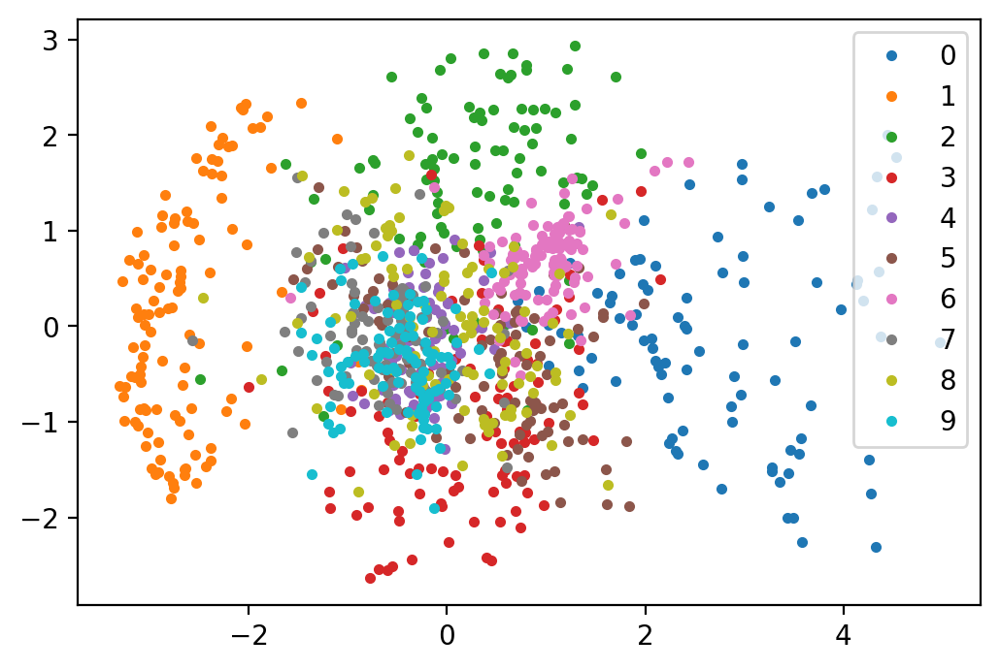

In [121]:
plot_latent(models[1], data)

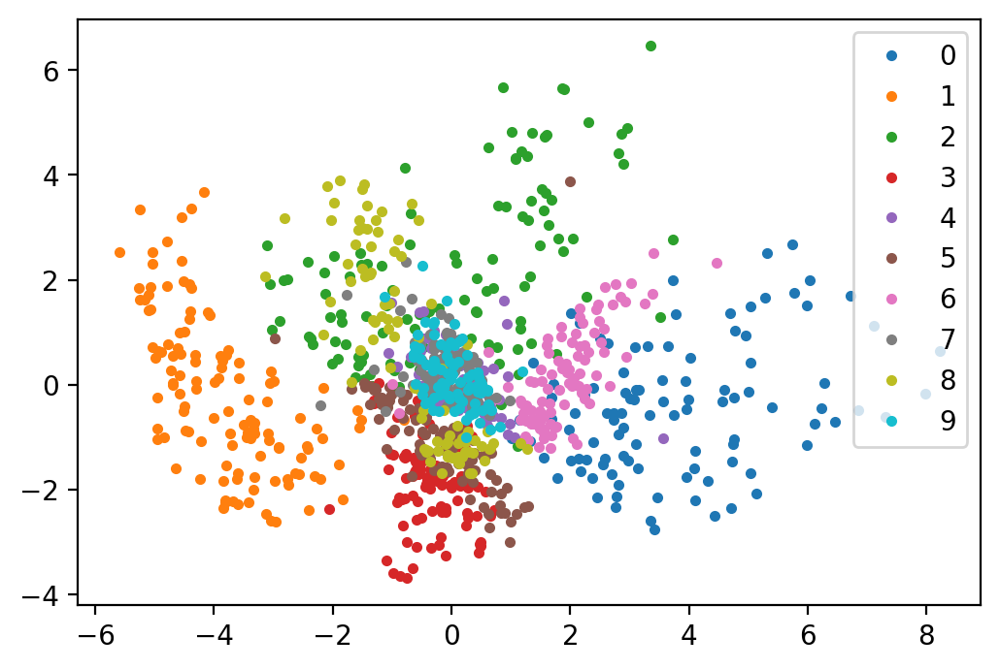

In [122]:
plot_latent(models[3], data)

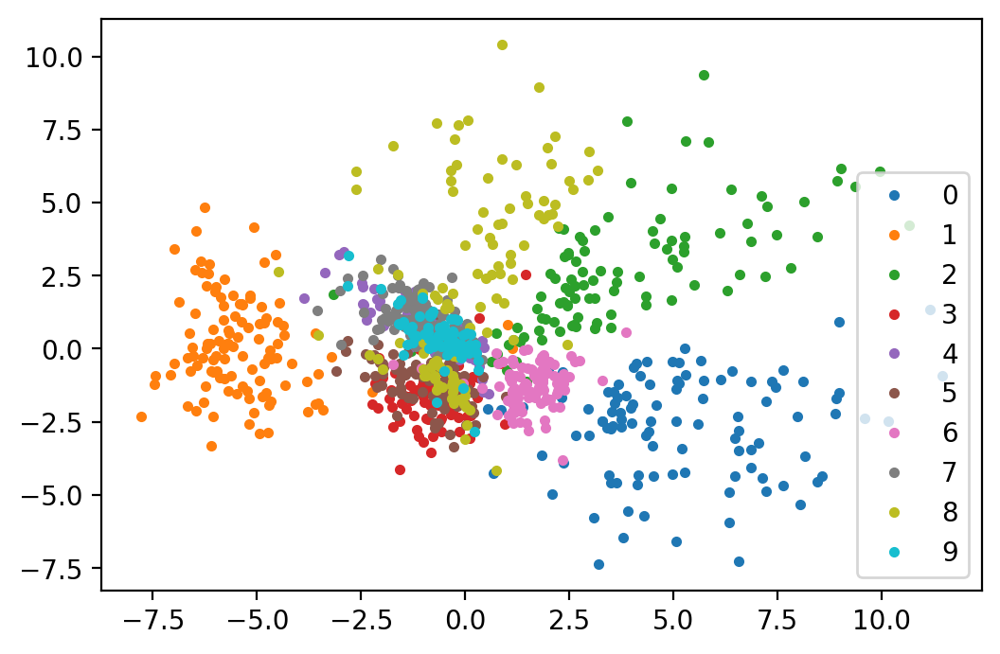

In [123]:
plot_latent(models[10], data)

Посмотрим на вектора большей размерности

In [98]:
def apply_PCA(X, dim=2):
    pca = PCA(2)
    return pca.fit_transform(X)

In [112]:
def plot_latent_with_PCA(autoencoder, data, num_batches=100):
    z_vecs = []
    classes = []
    for i, (x, y) in enumerate(data):
        z = autoencoder.encoder(x.to(device))
        z = z.to("cpu").detach().numpy()
        z_vecs.append(z)
        classes.append(y)
        if i > num_batches:
            break
    z_vecs = np.vstack(z_vecs)
    classes = np.hstack(classes)
    
    z_vecs_low = apply_PCA(z_vecs)
    
    for i in np.unique(classes):
        idx = np.where(classes == i)[0]
        plt.plot(z_vecs_low[idx, 0], z_vecs_low[idx, 1], '.', label = str(i))
        
    plt.legend(loc = 'best')

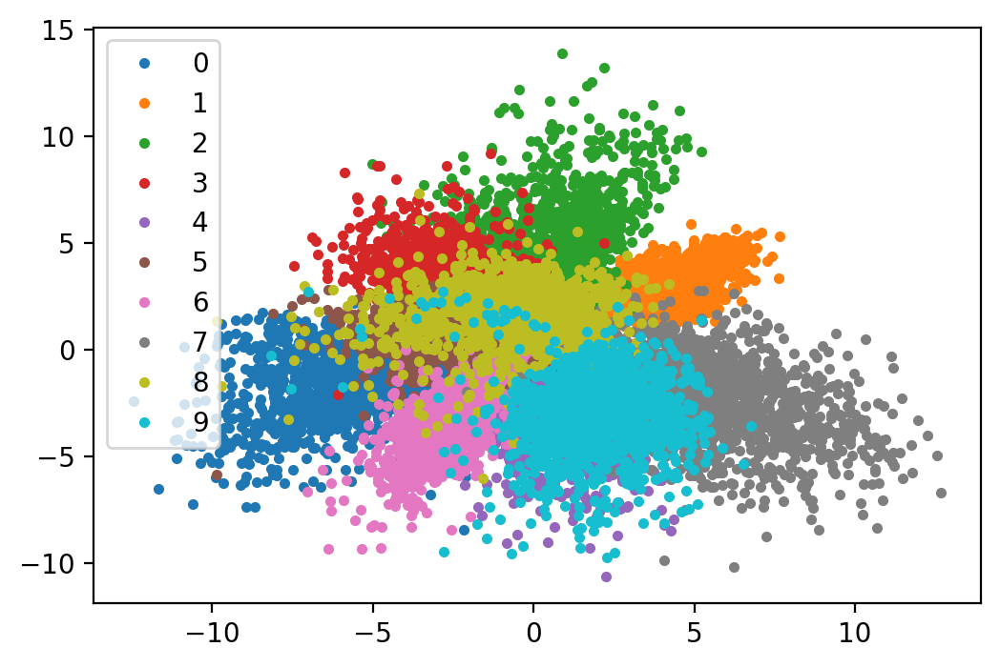

In [113]:
plot_latent_with_PCA(saved_models[0], data)

___
Видно, что доля объясненной PCA для двух главных компонент высока, большинство классов разделилось  

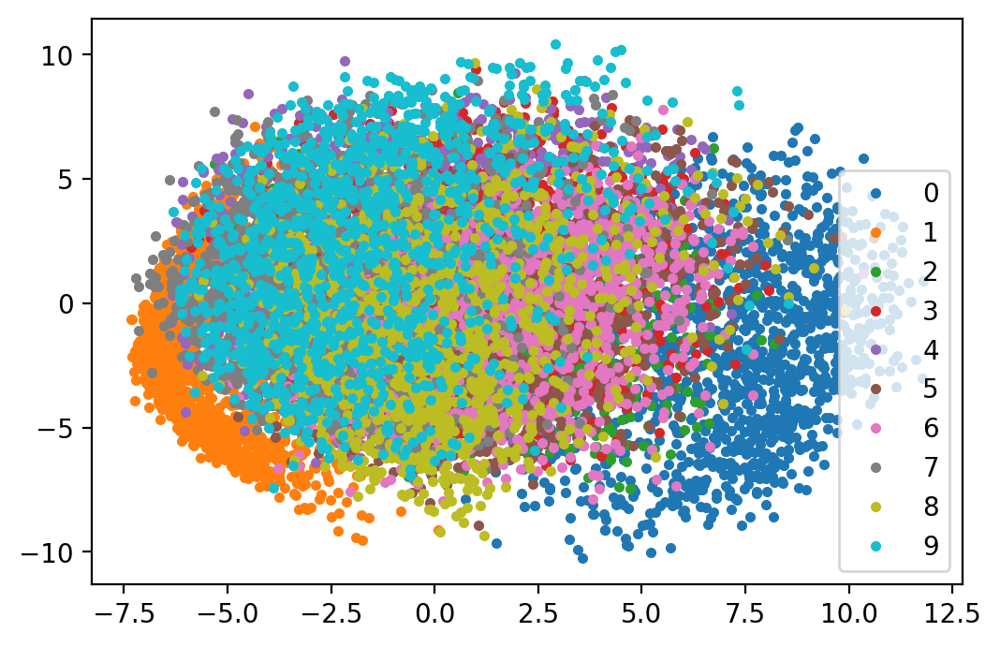

In [115]:
plot_latent_with_PCA(saved_models[1], data)

___
Для 16-мерного вектора (и более высокой размерности очевидно) двух компонент уже недостаточно, ~тройку классов разделяет отлично

In [125]:
def plot_reconstructed(autoencoder, r0=(-5, 10), r1=(-10, 5), n=12):
    w = 28
    img = np.zeros((n * w, n * w))
    for i, y in enumerate(np.linspace(*r1, n)):
        for j, x in enumerate(np.linspace(*r0, n)):
            z = torch.Tensor([[x, y]]).to(device)
            x_hat = autoencoder.decoder(z)
            x_hat = x_hat.reshape(28, 28).to("cpu").detach().numpy()
            img[(n - 1 - i) * w : (n - 1 - i + 1) * w, j * w : (j + 1) * w] = x_hat
    plt.imshow(img, extent=[*r0, *r1])

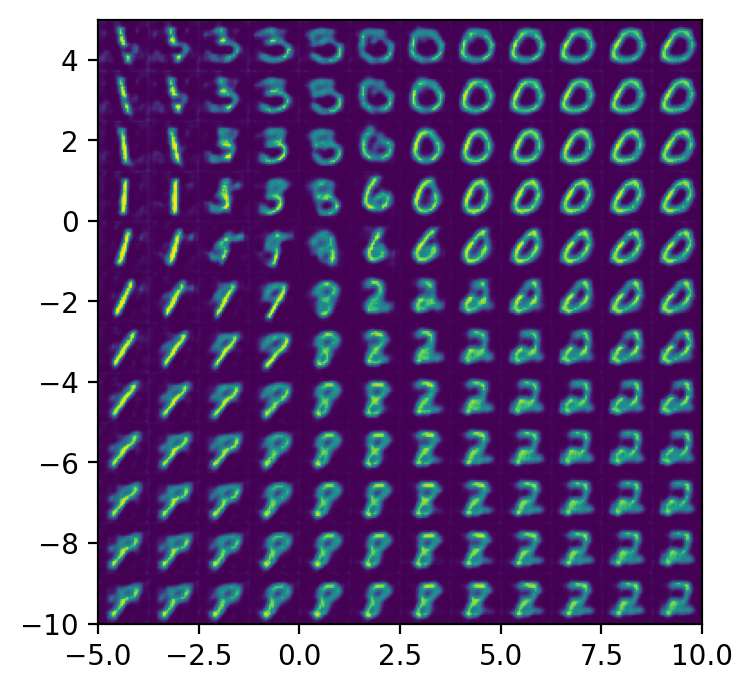

In [124]:
plot_reconstructed(models[10])

In [126]:
def interpolate(autoencoder, x_1, x_2, n=12):
    z_1 = autoencoder.encoder(x_1)
    z_2 = autoencoder.encoder(x_2)
    z = torch.stack([z_1 + (z_2 - z_1) * t for t in np.linspace(0, 1, n)])
    interpolate_list = autoencoder.decoder(z)
    interpolate_list = interpolate_list.to("cpu").detach().numpy()

    w = 28
    img = np.zeros((w, n * w))
    for i, x_hat in enumerate(interpolate_list):
        img[:, i * w : (i + 1) * w] = x_hat.reshape(28, 28)
    plt.imshow(img)
    plt.xticks([])
    plt.yticks([])

In [144]:
x, y = next(iter(data))
x_1 = x[y == 6][0].to(device) 
x_2 = x[y == 9][0].to(device) 

In [146]:
x_1 = x_1[None, :, :, :]
x_2 = x_2[None, :, :, :]

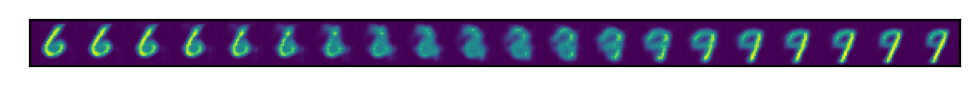

In [147]:
interpolate(models[10], x_1, x_2, n=20)